<a href="https://colab.research.google.com/github/DLSHW/cyclegan/blob/master/gan_zuccarrot.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

###Dataset downloading

In [0]:
from google.colab import drive
drive.mount('/content/gdrive/', force_remount=True)
!unzip -q /content/gdrive/My\ Drive/zuccarrot.zip 

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/gdrive/


In [0]:
dataset_path = 'zuccarrot/' 

### Library imports

In [0]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision import models
import torch.optim 
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
from torchvision.utils import save_image
import torchvision.transforms as transforms
from PIL import Image
from time import time
import datetime
import numpy as np
import itertools
import os
import glob
import random
import matplotlib.pyplot as plt
from matplotlib import rcParams
rcParams['figure.figsize'] = (20, 10)

torch.manual_seed(42)
np.random.seed(42)
torch.cuda.manual_seed(42)
torch.backends.cudnn.deterministic = True

In [0]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)

cuda


### Dataloader

In [0]:
class ImageDataset(Dataset):
    def __init__(self, files_path, data_transforms, mode='train'):
        self.transform = data_transforms

        self.files_A = sorted(glob.glob(os.path.join(files_path, '{}A/*.*'.format(mode))))
        self.files_B = sorted(glob.glob(os.path.join(files_path, '{}B/*.*'.format(mode))))

    def __getitem__(self, index):
        image_A = self.transform(Image.open(self.files_A[index % len(self.files_A)]))
        image_B = self.transform(Image.open(self.files_B[index % len(self.files_B)]))
        return {'A': image_A, 'B': image_B}

    def __len__(self):
        return max(len(self.files_A), len(self.files_B))

In [0]:
batch_size = 5

In [0]:
dataset = ImageDataset(files_path=dataset_path,
                       data_transforms=transforms.Compose([
                           transforms.Resize((286, 286), Image.BICUBIC),
                           transforms.RandomCrop((256, 256)),
                           transforms.RandomHorizontalFlip(),
                           transforms.ToTensor(),
                           transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
                          ]),
                       )

dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=True)

### Generator

In [0]:
class ResidualBlock(nn.Module):
    def __init__(self, in_channels):
        super(ResidualBlock, self).__init__()

        self.res = nn.Sequential(nn.ReflectionPad2d(1),
                                 nn.Conv2d(in_channels, in_channels, kernel_size=(3, 3)),
                                 nn.InstanceNorm2d(in_channels),
                                 nn.ReLU(inplace=True),
                                 nn.ReflectionPad2d(1),
                                 nn.Conv2d(in_channels, in_channels, kernel_size=(3, 3)),
                                 nn.InstanceNorm2d(in_channels))

    def forward(self, x):
        return x + self.res(x)

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()

        self.layers = nn.Sequential(
                  nn.ReflectionPad2d(3),
                  nn.Conv2d(3, 64, 7, stride=1, padding=0),
                  nn.InstanceNorm2d(64),
                  nn.ReLU(inplace=True),
                  
                  nn.ReflectionPad2d(1),
                  nn.Conv2d(64, 128, 3, stride=2, padding=0), 
                  nn.InstanceNorm2d(128),
                  nn.ReLU(inplace=True),
                  nn.ReflectionPad2d(1),
                  nn.Conv2d(128, 256, 3, stride=2, padding=0), 
                  nn.InstanceNorm2d(256),
                  nn.ReLU(inplace=True),

                  ResidualBlock(256),
                  ResidualBlock(256),
                  ResidualBlock(256),
                  ResidualBlock(256),
                  ResidualBlock(256),
                  ResidualBlock(256),
                  ResidualBlock(256),
                  ResidualBlock(256),
                  ResidualBlock(256),

                  nn.ConvTranspose2d(256, 128, 4, stride=2, padding=1),
                  nn.InstanceNorm2d(128),
                  nn.ReLU(inplace=True),
                  nn.ConvTranspose2d(128, 64, 4, stride=2, padding=1),
                  nn.InstanceNorm2d(64),
                  nn.ReLU(inplace=True),

                  nn.ReflectionPad2d(3),
                  nn.Conv2d(64, 3, 7, stride=1, padding=0),
                  nn.Tanh()
        )
        
    def forward(self, x):
        x = self.layers(x)
        return x

###  Discriminator

In [0]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()

        self.layers = nn.Sequential(
            nn.ReflectionPad2d(1),
            nn.Conv2d(3, 64, 4, stride=2, padding=0), # 256 -> 128
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.ReflectionPad2d(1),
            nn.Conv2d(64, 128, 4, stride=2, padding=0),  # 128 -> 64
            nn.InstanceNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),

            nn.ReflectionPad2d(1),
            nn.Conv2d(128, 256, 4, stride=2, padding=0), # 64 -> 32
            nn.InstanceNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.ReflectionPad2d(1),
            nn.Conv2d(256, 512, 4, padding=0), # 32 -> 31
            nn.InstanceNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.ReflectionPad2d(1),
            nn.Conv2d(512, 1, 4, padding=0),  # 31 -> 30
        )

    def forward(self, x):
        x = self.layers(x)
        x = F.avg_pool2d(x, x.size()[2:])  # 30 -> 1
        x = torch.flatten(x, 1) 
        return x

### Auxiliary functions

In [0]:
def weights_init_normal(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
      torch.nn.init.normal_(m.weight, 0.0, 0.02)
      if hasattr(m, 'bias') and m.bias is not None:
        torch.nn.init.constant_(m.bias.data, 0.0)

In [0]:
def visualize(loss_dict):
    i = 1
    for key in loss_dict:
      plt.subplot(5, 2, i)
      plt.plot(loss_dict[key], label = key+'_train')
      plt.title(key)
      plt.xlabel('Epochs')
      plt.ylabel(key)
      plt.legend()
      i += 1
    plt.show()

In [0]:
class ReplayBuffer():
    def __init__(self, max_size=50):
        assert (max_size > 0), 'max_size should be > 0'
        self.max_size = max_size
        self.data = []

    def push_and_pop(self, data):
        to_return = []
        for element in data.data:
            element = torch.unsqueeze(element, 0)
            if len(self.data) < self.max_size:
                self.data.append(element)
                to_return.append(element)
            else:
                if random.uniform(0,1) > 0.5:
                    i = random.randint(0, self.max_size-1)
                    to_return.append(self.data[i].clone())
                    self.data[i] = element
                else:
                    to_return.append(element)
        return torch.cat(to_return)

### Initialize model, loss, optimizer

In [0]:
Generator_A2B = Generator().to(device)
Generator_B2A = Generator().to(device)
Discriminator_A = Discriminator().to(device)
Discriminator_B = Discriminator().to(device)

In [0]:
Generator_A2B.apply(weights_init_normal)
Generator_B2A.apply(weights_init_normal)
Discriminator_A.apply(weights_init_normal)
Discriminator_B.apply(weights_init_normal)

In [0]:
criterion_GAN = torch.nn.MSELoss()
criterion_cycle = torch.nn.L1Loss()
criterion_identity = torch.nn.L1Loss()

In [0]:
optimizer_G = torch.optim.Adam(itertools.chain(Generator_A2B.parameters(), Generator_B2A.parameters()), lr=2e-4)
optimizer_D_A = torch.optim.Adam(Discriminator_A.parameters(), lr=2e-4)
optimizer_D_B = torch.optim.Adam(Discriminator_B.parameters(), lr=2e-4)

lr_scheduler_G = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer_G, mode='min', factor=0.1, patience=10)
lr_scheduler_D_A = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer_D_A, mode='min', factor=0.1, patience=10)
lr_scheduler_D_B = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer_D_B, mode='min', factor=0.1, patience=10)

In [0]:
Tensor = torch.cuda.FloatTensor 
input_A = Tensor(batch_size, 3, 256, 256)
input_B = Tensor(batch_size, 3, 256, 256)

target_real = Tensor(batch_size, 1).fill_(1.0)
target_fake = Tensor(batch_size, 1).fill_(0.0)

fake_A_buffer = ReplayBuffer()
fake_B_buffer = ReplayBuffer()

### Training

In [0]:
num_epochs = 100

loss_GAN_A2B_history = []
loss_GAN_B2A_history = []
loss_cycle_ABA_history = []
loss_cycle_BAB_history = []
loss_D_A_history = []
loss_D_B_history = []
identity_loss_A_history = []
identity_loss_B_history = []
G_loss_history = []
D_loss_history = []

In [0]:
Generator_A2B.train()
Generator_B2A.train()
Discriminator_A.train()
Discriminator_B.train()

prev_time = time()
for epoch in range(num_epochs):
    loss_GAN_A2B_sum = 0.
    loss_GAN_B2A_sum = 0.
    loss_cycle_ABA_sum = 0.
    loss_cycle_BAB_sum = 0.
    loss_D_A_sum = 0.
    loss_D_B_sum = 0.
    identity_loss_A_sum = 0.
    identity_loss_B_sum = 0.
    G_loss_sum = 0.
    D_loss_sum = 0.
    since = time()
    for i, batch in enumerate(dataloader):
        real_A = input_A.copy_(batch['A'])
        real_B = input_B.copy_(batch['B'])

        optimizer_G.zero_grad()

        # Identity loss
        identity_A = Generator_B2A(real_A)
        identity_loss_A = criterion_identity(identity_A, real_A)*0.5

        identity_B = Generator_A2B(real_B)
        identity_loss_B = criterion_identity(identity_B, real_B)*0.5
        
        identity_loss_A_sum += identity_loss_A.item()
        identity_loss_B_sum += identity_loss_B.item()
        
        # Adversarial loss
        fake_B = Generator_A2B(real_A)
        pred_fake = Discriminator_B(fake_B)
        loss_GAN_A2B = criterion_GAN(pred_fake, target_real)*0.5

        fake_A = Generator_B2A(real_B)
        pred_fake = Discriminator_A(fake_A)
        loss_GAN_B2A = criterion_GAN(pred_fake, target_real)*0.5

        loss_GAN_A2B_sum += loss_GAN_A2B.item()
        loss_GAN_B2A_sum += loss_GAN_B2A.item()
        
        # Cycle loss
        recovered_A = Generator_B2A(fake_B)
        loss_cycle_ABA = criterion_cycle(recovered_A, real_A)*5.

        recovered_B = Generator_A2B(fake_A)
        loss_cycle_BAB = criterion_cycle(recovered_B, real_B)*5.
        
        loss_cycle_ABA_sum += loss_cycle_ABA.item()
        loss_cycle_BAB_sum += loss_cycle_BAB.item()
        
        # Generator loss =  adversarial loss + cycle loss + identity loss
        loss_G = loss_GAN_A2B + loss_GAN_B2A + loss_cycle_ABA + loss_cycle_BAB + identity_loss_A + identity_loss_B

        G_loss_sum += loss_G.item()

        loss_G.backward()
        optimizer_G.step()

        optimizer_D_A.zero_grad()

        # DiscriminatorA loss
        pred_real = Discriminator_A(real_A)
        loss_D_real = criterion_GAN(pred_real, target_real)

        fake_A = fake_A_buffer.push_and_pop(fake_A)
        pred_fake = Discriminator_A(fake_A.detach()) 
        loss_D_fake = criterion_GAN(pred_fake, target_fake)

        loss_D_A = (loss_D_real + loss_D_fake)*0.5

        loss_D_A_sum += loss_D_A.item()

        loss_D_A.backward()
        optimizer_D_A.step()

        optimizer_D_B.zero_grad()

        # DiscriminatorB loss
        pred_real = Discriminator_B(real_B)
        loss_D_real = criterion_GAN(pred_real, target_real)
        
        fake_B = fake_B_buffer.push_and_pop(fake_B)
        pred_fake = Discriminator_B(fake_B.detach())
        loss_D_fake = criterion_GAN(pred_fake, target_fake)

        loss_D_B = (loss_D_real + loss_D_fake)*0.5
        
        loss_D_B_sum += loss_D_B.item()

        loss_D_B.backward()
        optimizer_D_B.step()

        D_loss_sum += (loss_D_A + loss_D_B).item()


        batches_done = epoch * len(dataloader) + i
        batches_left = num_epochs * len(dataloader) - batches_done
        time_left = datetime.timedelta(seconds=batches_left * (time() - prev_time))
        prev_time = time()

        print(
            "\r|Epoch {}/{}| |Batch {}/{}| |D_loss: {:.3f}| |G_loss: {:.3f}, adv: {:.3f}, cycle: {:.3f}, identity: {:.3f}| |Time_left: {}|". \
            format(epoch,
                   num_epochs,
                   i,
                   len(dataloader),
                   (loss_D_A + loss_D_B).item(),
                   loss_G.item(),
                   (loss_GAN_A2B + loss_GAN_B2A).item(),
                   (loss_cycle_ABA + loss_cycle_BAB).item(),
                   (identity_loss_A + identity_loss_B).item(),
                   time_left
              )
        )

        lr_scheduler_G.step(loss_G)
        lr_scheduler_D_A.step(loss_D_A)
        lr_scheduler_D_B.step(loss_D_B)
    
    loss_GAN_A2B_history.append(loss_GAN_A2B_sum/len(dataloader))
    loss_GAN_B2A_history.append(loss_GAN_B2A_sum/len(dataloader))
    loss_cycle_ABA_history.append(loss_cycle_ABA_sum/len(dataloader))
    loss_cycle_BAB_history.append(loss_cycle_BAB_sum/len(dataloader))
    loss_D_A_history.append(loss_D_A_sum/len(dataloader))
    loss_D_B_history.append(loss_D_B_sum/len(dataloader))
    identity_loss_A_history.append(identity_loss_A_sum/len(dataloader))
    identity_loss_B_history.append(identity_loss_B_sum/len(dataloader))
    G_loss_history.append(G_loss_sum/len(dataloader))
    D_loss_history.append(D_loss_sum/len(dataloader))
    

Streaming output truncated to the last 5000 lines.
|Epoch 54/100| |Batch 61/110| |D_loss: 0.664| |G_loss: 2.702, adv: 0.168, cycle: 2.307, identity: 0.227| |Time_left: 3:03:08.222496|
|Epoch 54/100| |Batch 62/110| |D_loss: 0.673| |G_loss: 2.285, adv: 0.144, cycle: 1.945, identity: 0.196| |Time_left: 3:02:41.486654|
|Epoch 54/100| |Batch 63/110| |D_loss: 0.648| |G_loss: 2.467, adv: 0.140, cycle: 2.109, identity: 0.218| |Time_left: 3:03:36.095982|
|Epoch 54/100| |Batch 64/110| |D_loss: 0.608| |G_loss: 2.665, adv: 0.134, cycle: 2.302, identity: 0.230| |Time_left: 3:03:00.347769|
|Epoch 54/100| |Batch 65/110| |D_loss: 0.555| |G_loss: 2.610, adv: 0.197, cycle: 2.195, identity: 0.219| |Time_left: 3:02:54.181859|
|Epoch 54/100| |Batch 66/110| |D_loss: 0.674| |G_loss: 2.548, adv: 0.153, cycle: 2.173, identity: 0.222| |Time_left: 3:03:22.315760|
|Epoch 54/100| |Batch 67/110| |D_loss: 0.673| |G_loss: 2.759, adv: 0.182, cycle: 2.350, identity: 0.227| |Time_left: 3:02:57.033903|
|Epoch 54/100| |Ba

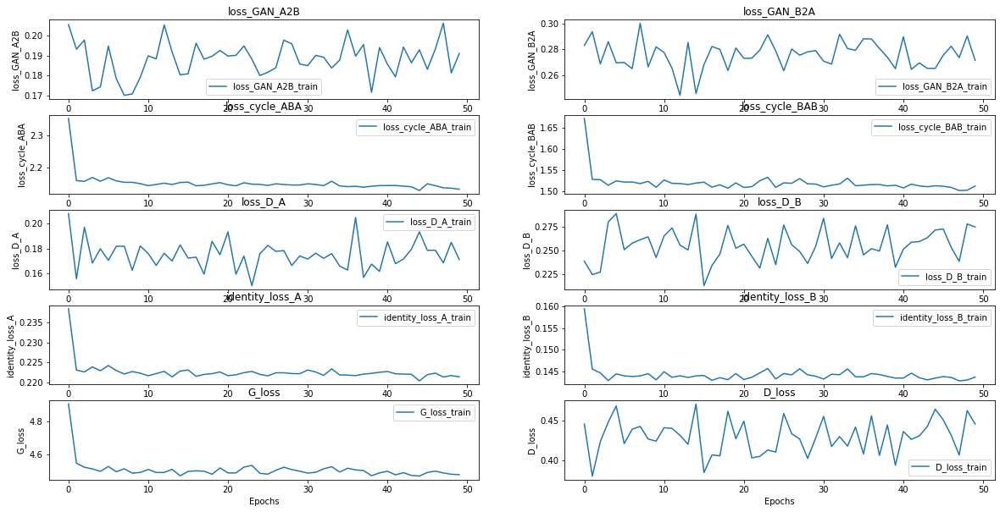

In [0]:
loss_dict = {'loss_GAN_A2B': loss_GAN_A2B_history,
             'loss_GAN_B2A': loss_GAN_B2A_history,
             'loss_cycle_ABA': loss_cycle_ABA_history,
             'loss_cycle_BAB': loss_cycle_BAB_history,
             'loss_D_A': loss_D_A_history,
             'loss_D_B': loss_D_B_history,
             'identity_loss_A': identity_loss_A_history,
             'identity_loss_B': identity_loss_B_history,
             'G_loss': G_loss_history,
             'D_loss': D_loss_history}
visualize(loss_dict)

In [0]:
torch.save(Generator_A2B.state_dict(), "gdrive/My Drive/G_AB.pth")
torch.save(Generator_B2A.state_dict(), 'gdrive/My Drive/G_BA.pth')
torch.save(Discriminator_A.state_dict(), 'gdrive/My Drive/D_A.pth')
torch.save(Discriminator_B.state_dict(), 'gdrive/My Drive/D_B.pth')

### Testing

In [0]:
Generator_A2B.eval()
Generator_B2A.eval()

In [0]:
Tensor = torch.cuda.FloatTensor 
input_A = Tensor(batch_size, 3, 256, 256)
input_B = Tensor(batch_size, 3, 256, 256)

data_transforms = transforms.Compose([transforms.Resize((256, 256)),
                                      transforms.ToTensor(),
                                      transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)) 
                ])

dataloader_test = DataLoader(ImageDataset(files_path=dataset_path, 
                                          data_transforms=data_transforms, 
                                          mode='test'), 
                             batch_size=1, 
                             shuffle=False, 
                             num_workers=4)

In [0]:
!rm -r output

In [0]:
if not os.path.exists('output/A_fake'):
    os.makedirs('output/A_fake')
if not os.path.exists('output/B_fake'):
    os.makedirs('output/B_fake')
if not os.path.exists('output/A_rec'):
    os.makedirs('output/A_rec')
if not os.path.exists('output/B_rec'):
    os.makedirs('output/B_rec')

for i, batch in enumerate(dataloader_test):
    real_A = input_A.copy_(batch['A'])
    real_B = input_B.copy_(batch['B'])

    fake_B = 0.5*(Generator_A2B(real_A).data + 1.0)
    fake_A = 0.5*(Generator_B2A(real_B).data + 1.0)

    rec_B = 0.5*(Generator_A2B(fake_A).data + 1.0)
    rec_A = 0.5*(Generator_B2A(fake_B).data + 1.0)

    save_image(fake_A[0], 'output/A_fake/{:04d}.png'.format(i+1))
    save_image(fake_B[0], 'output/B_fake/{:04d}.png'.format(i+1))
    save_image(rec_A[0], 'output/A_rec/{:04d}.png'.format(i+1))
    save_image(rec_B[0], 'output/B_rec/{:04d}.png'.format(i+1))

### Apple2orange dataset

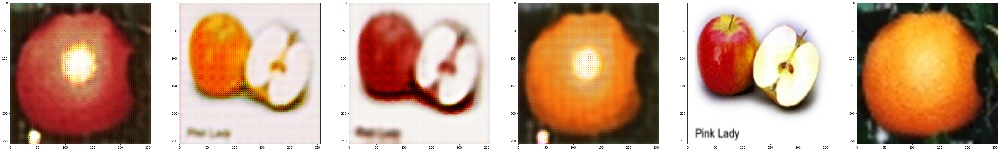

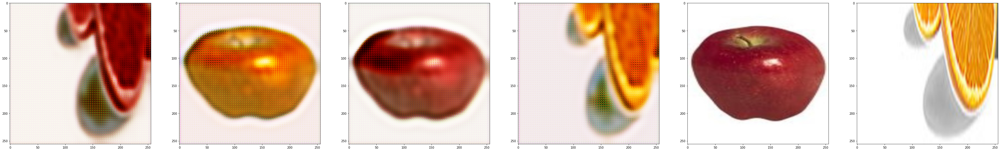

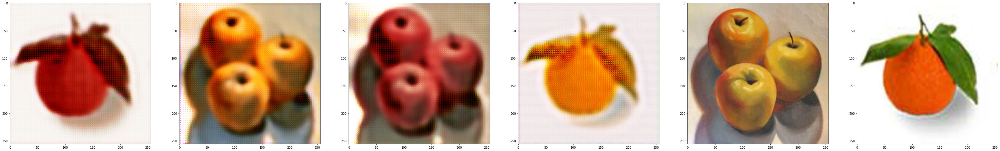

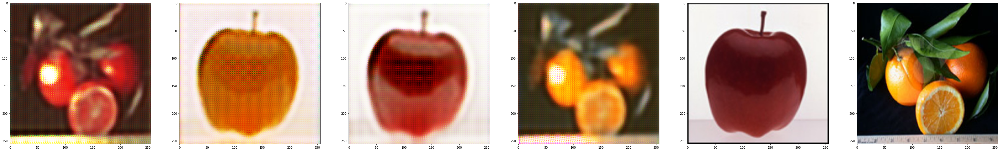

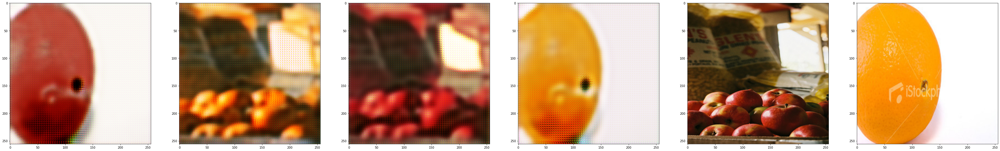

In [0]:
n = 5
lst_A_fake = sorted(glob.glob('output/A_fake/*.*'))
lst_B_fake = sorted(glob.glob('output/B_fake/*.*'))
lst_A_rec = sorted(glob.glob('output/A_rec/*.*'))
lst_B_rec = sorted(glob.glob('output/B_rec/*.*'))
lst_A_real = sorted(glob.glob(dataset_path + 'testA/*.*'))
lst_B_real = sorted(glob.glob(dataset_path + 'testB/*.*'))
for i in range(n):
  plt.figure(figsize=(60, 60))
  plt.subplot(n, 6, 1)
  plt.imshow(Image.open(lst_A_fake[i]))
  plt.subplot(n, 6, 2)
  plt.imshow(Image.open(lst_B_fake[i]))
  plt.subplot(n, 6, 3)
  plt.imshow(Image.open(lst_A_rec[i]))
  plt.subplot(n, 6, 4)
  plt.imshow(Image.open(lst_B_rec[i]))
  plt.subplot(n, 6, 5)
  plt.imshow(Image.open(lst_A_real[i]))
  plt.subplot(n, 6, 6)
  plt.imshow(Image.open(lst_B_real[i]))

### My dataset

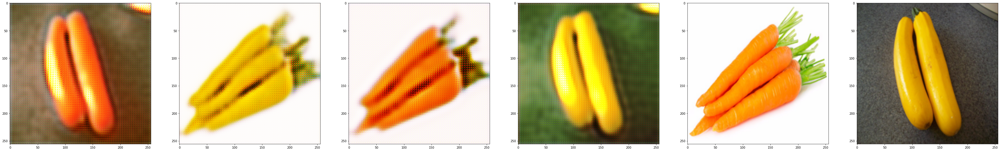

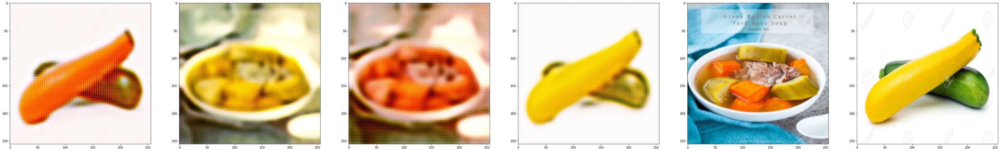

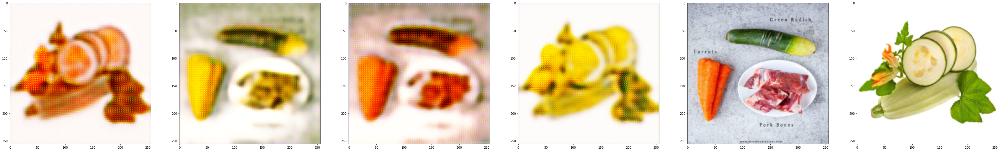

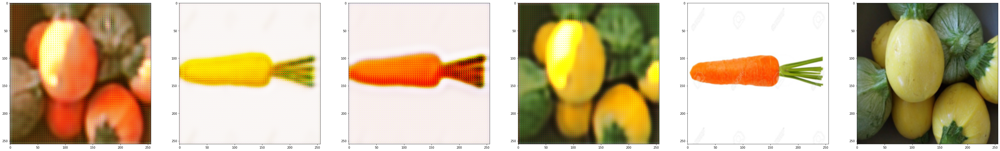

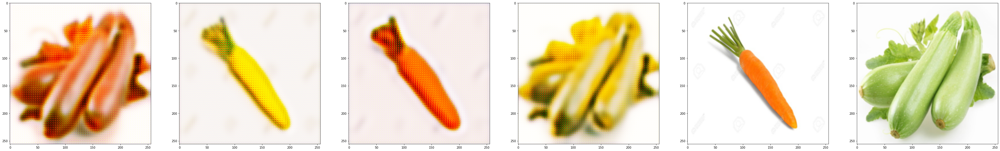

In [0]:
n = 5
lst_A_fake = sorted(glob.glob('output/A_fake/*.*'))
lst_B_fake = sorted(glob.glob('output/B_fake/*.*'))
lst_A_rec = sorted(glob.glob('output/A_rec/*.*'))
lst_B_rec = sorted(glob.glob('output/B_rec/*.*'))
lst_A_real = sorted(glob.glob(dataset_path + 'testA/*.*'))
lst_B_real = sorted(glob.glob(dataset_path + 'testB/*.*'))
for i in range(n):
  plt.figure(figsize=(60, 60))
  plt.subplot(n, 6, 1)
  plt.imshow(Image.open(lst_A_fake[i]))
  plt.subplot(n, 6, 2)
  plt.imshow(Image.open(lst_B_fake[i]))
  plt.subplot(n, 6, 3)
  plt.imshow(Image.open(lst_A_rec[i]))
  plt.subplot(n, 6, 4)
  plt.imshow(Image.open(lst_B_rec[i]))
  plt.subplot(n, 6, 5)
  plt.imshow(transforms.Resize((256, 256))(Image.open(lst_A_real[i])))
  plt.subplot(n, 6, 6)
  plt.imshow(transforms.Resize((256, 256))(Image.open(lst_B_real[i])))